<a href="https://colab.research.google.com/github/jiheeko/Seperation-of-waste-by-materials/blob/main/Detectron2_FPN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Introduction

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator` and set it to `GPU`.

In [1]:
!nvidia-smi # 하드웨어 가속기를 GPU로 설정

Mon Dec  4 11:38:57 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Install Detectron2 and dependencies

In [2]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git' # detectron2 설치

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-gahcvv4n
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-gahcvv4n
  Resolved https://github.com/facebookresearch/detectron2.git to commit 5de5319a49e7ea819586d3d6a817632392dfdeb2
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 16.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6118757 sha256=ce3568cabfb04b1546f651e4fce06

Now is a good time to confirm that we have the right versions of the libraries at our disposal.

In [3]:
# detectron2와 그 외 필요한 라이브러리가 설치되었는지 확인
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.1 ; cuda:  cu118
detectron2: 0.6


In [4]:
# 설치한 라이브러리에서 필요한 함수 불러오기
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# TRAINING
from detectron2.engine import DefaultTrainer

## COCO Format Dataset

### Download

In [5]:
# 모델 훈련에 필요한 데이터셋 불러오기 (로보플로우 설치)
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="9GioxqxzCYuJPY1ofooi")
project = rf.workspace("team-project-ani7l").project("seperation-of-waste-by-materials")
dataset = project.version(10).download("coco-segmentation")


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.5/68.5 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.3 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.1.78
    Uninstalling opencv-python-headless-4.8.1.78:
      Successfully uninstal

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Seperation-of-waste-by-materials-10 in coco-segmentation:: 100%|██████████| 680/680 [00:00<00:00, 5820.49it/s]


### Register

When you use Detectron2, before you actually train the model you need to [register it](https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html#register-a-coco-format-dataset).

In [6]:
DATA_SET_NAME = dataset.name.replace(" ", "-")
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [7]:
# 훈련, 검증, 테스트 데이터셋 분류
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "train", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TRAIN_DATA_SET_NAME,
    metadata={},
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH,
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "test")
TEST_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "test", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TEST_DATA_SET_NAME,
    metadata={},
    json_file=TEST_DATA_SET_ANN_FILE_PATH,
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "valid")
VALID_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "valid", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=VALID_DATA_SET_NAME,
    metadata={},
    json_file=VALID_DATA_SET_ANN_FILE_PATH,
    image_root=VALID_DATA_SET_IMAGES_DIR_PATH
)

We can now confirm that our custom dataset was correctly registered using [MetadataCatalog](https://detectron2.readthedocs.io/en/latest/modules/data.html#detectron2.data.MetadataCatalog).

In [8]:
# 불러온 데이터셋이 잘 분류 되었는지 확인
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['Seperation-of-waste-by-materials-train',
 'Seperation-of-waste-by-materials-test',
 'Seperation-of-waste-by-materials-valid']

## Train Model Using Custom COCO Format Dataset

### Configuration

In [9]:
# detectron2에 내장된 DefaultTrainer에 COCOEvaluator를 적용하여 코드를 훈련하면 AP값이 나오도록 새로운 CocoTrainer 설계

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [10]:
# 훈련 하이퍼 파라미터 설정
# HYPERPARAMETERS
ARCHITECTURE = "mask_rcnn_R_101_FPN_3x" # backbone network : FPN
CONFIG_FILE_PATH = f"COCO-InstanceSegmentation/{ARCHITECTURE}.yaml"
MAX_ITER = 1000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 7

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME,
    ARCHITECTURE,
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [11]:
# 모델 훈련에 사용할 configuration 코드

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH) # 초기 가중치
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

### Training

In [12]:
# configuration 기반으로 CocoTrainer 이용해 모델 훈련
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/04 11:43:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:01, 143MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/04 11:43:53 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)


[12/04 11:44:09 d2.utils.events]:  eta: 0:08:45  iter: 19  total_loss: 3.692  loss_cls: 2.244  loss_box_reg: 0.7076  loss_mask: 0.6924  loss_rpn_cls: 0.003463  loss_rpn_loc: 0.004417    time: 0.5976  last_time: 0.4776  data_time: 0.0356  last_data_time: 0.0210   lr: 1.9981e-05  max_mem: 2496M
[12/04 11:44:24 d2.utils.events]:  eta: 0:07:56  iter: 39  total_loss: 3.085  loss_cls: 1.609  loss_box_reg: 0.7518  loss_mask: 0.6657  loss_rpn_cls: 0.007313  loss_rpn_loc: 0.004964    time: 0.5224  last_time: 0.4289  data_time: 0.0130  last_data_time: 0.0066   lr: 3.9961e-05  max_mem: 2496M
[12/04 11:44:33 d2.utils.events]:  eta: 0:07:34  iter: 59  total_loss: 2.337  loss_cls: 0.8498  loss_box_reg: 0.7505  loss_mask: 0.6212  loss_rpn_cls: 0.02374  loss_rpn_loc: 0.007895    time: 0.5019  last_time: 0.4230  data_time: 0.0135  last_data_time: 0.0071   lr: 5.9941e-05  max_mem: 2496M
[12/04 11:44:42 d2.utils.events]:  eta: 0:06:58  iter: 79  total_loss: 2.029  loss_cls: 0.6511  loss_box_reg: 0.7591  

In [13]:
# 텐서보드를 이용해 training curves 출력
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

<IPython.core.display.Javascript object>

## Validation Model Using Custom COCO Format Dataset

In [14]:
# 모델 검증에 사용할 configuration 코드

cfg_additional = get_cfg()
cfg_additional.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg_additional.MODEL.WEIGHTS = os.path.join(OUTPUT_DIR_PATH, "model_final.pth")  # 훈련에서 얻은 가중치 불러오기
cfg_additional.DATASETS.TRAIN = (VALID_DATA_SET_NAME,)
cfg_additional.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg_additional.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg_additional.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg_additional.DATALOADER.NUM_WORKERS = 2
cfg_additional.SOLVER.IMS_PER_BATCH = 2
cfg_additional.INPUT.MASK_FORMAT='bitmask'
cfg_additional.SOLVER.BASE_LR = BASE_LR
cfg_additional.SOLVER.MAX_ITER = MAX_ITER  # 추가 훈련 iteration 설정
cfg_additional.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg_additional.OUTPUT_DIR = OUTPUT_DIR_PATH

In [15]:
# configuration 기반으로 모델 검증
trainer = CocoTrainer(cfg_additional)
trainer.resume_or_load(resume=False)
trainer.train()

[12/04 11:53:04 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [16]:
# 텐서보드를 이용해 validation curves 출력
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 4112), started 0:08:48 ago. (Use '!kill 4112' to kill it.)

<IPython.core.display.Javascript object>

## Test Model Using Custom COCO Format Dataset

In [17]:
# 모델 테스트에 사용할 configuration 코드

cfg_test = get_cfg()
cfg_test.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg_test.MODEL.WEIGHTS = os.path.join(OUTPUT_DIR_PATH, "model_final.pth")  # 검증에서 얻은 가중치
cfg_test.DATASETS.TRAIN = (TEST_DATA_SET_NAME,)
cfg_test.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg_test.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg_test.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg_test.DATALOADER.NUM_WORKERS = 2
cfg_test.SOLVER.IMS_PER_BATCH = 2
cfg_test.INPUT.MASK_FORMAT='bitmask'
cfg_test.SOLVER.BASE_LR = BASE_LR
cfg_test.SOLVER.MAX_ITER = MAX_ITER  # 추가 훈련 iteration 설정
cfg_test.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg_test.OUTPUT_DIR = OUTPUT_DIR_PATH

In [18]:
# configuration 기반으로 모델 테스트
trainer = CocoTrainer(cfg_test)
trainer.resume_or_load(resume=False)
trainer.train()

[12/04 12:01:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [19]:
# 텐서보드를 이용해 test curves 출력
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 4112), started 0:17:35 ago. (Use '!kill 4112' to kill it.)

<IPython.core.display.Javascript object>

### Evaluation

In [20]:
cfg_additional.MODEL.WEIGHTS = os.path.join(cfg_additional.OUTPUT_DIR, "model_final.pth")
cfg_additional.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg_test) # test 할 때 사용했던 configuration을 그대로 적용

[12/04 12:10:37 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from Seperation-of-waste-by-materials/mask_rcnn_R_101_FPN_3x/2023-12-04-11-43-49/model_final.pth ...


WARNING [12/04 12:10:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/04 12:10:37 d2.data.datasets.coco]: Loaded 64 images in COCO format from /content/Seperation-of-waste-by-materials-10/test/_annotations.coco.json


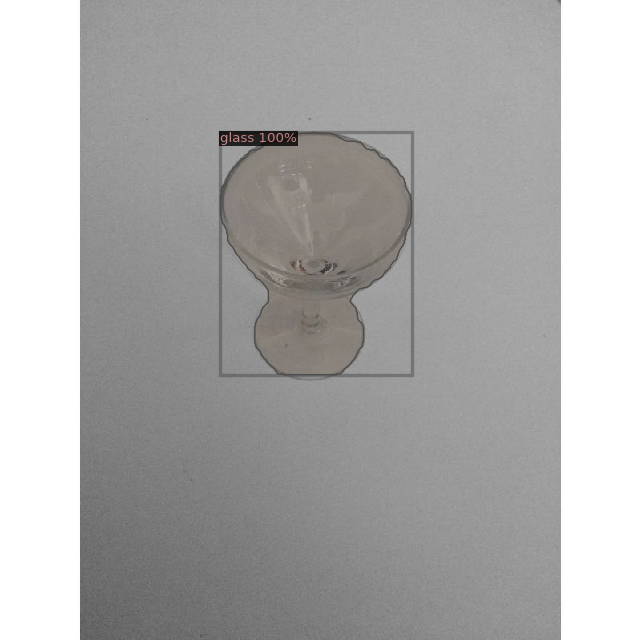

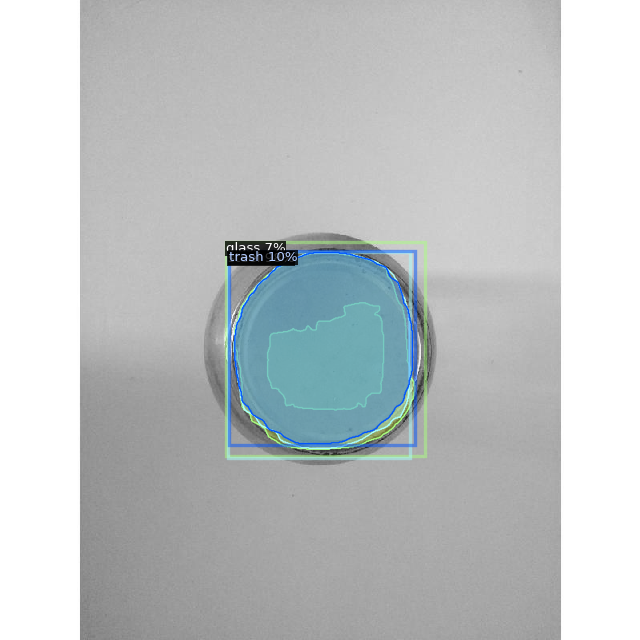

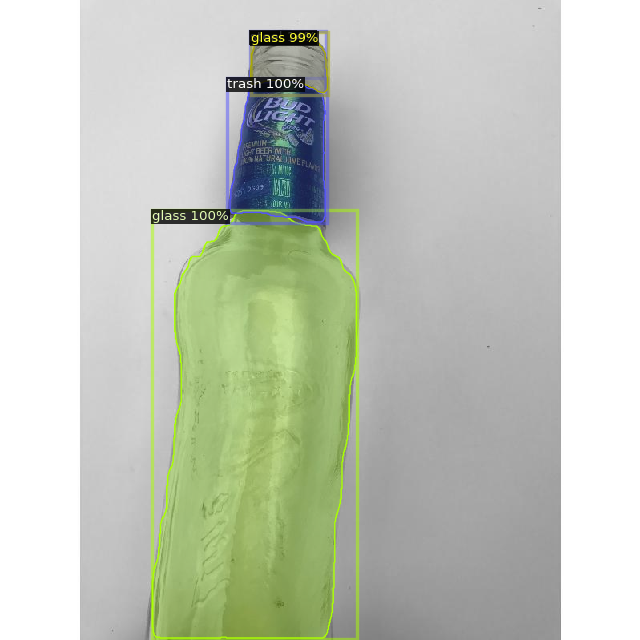

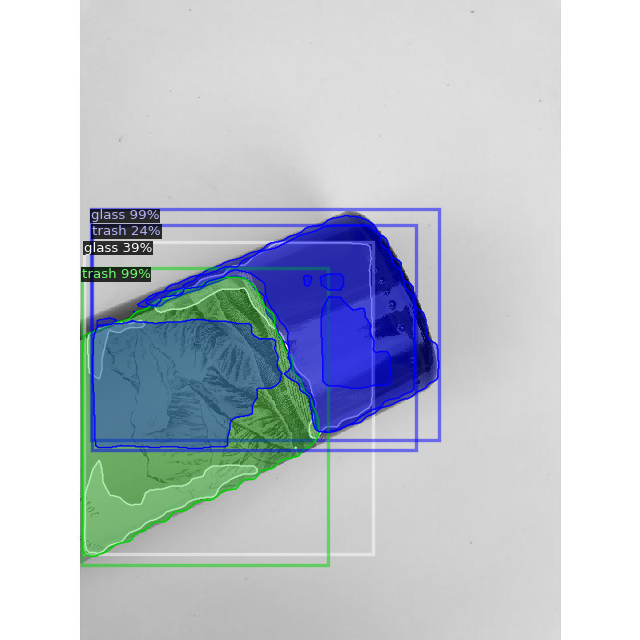

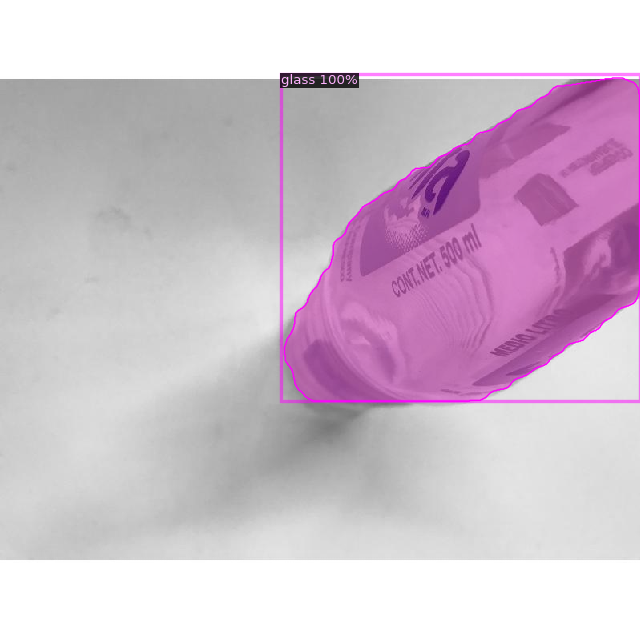

...

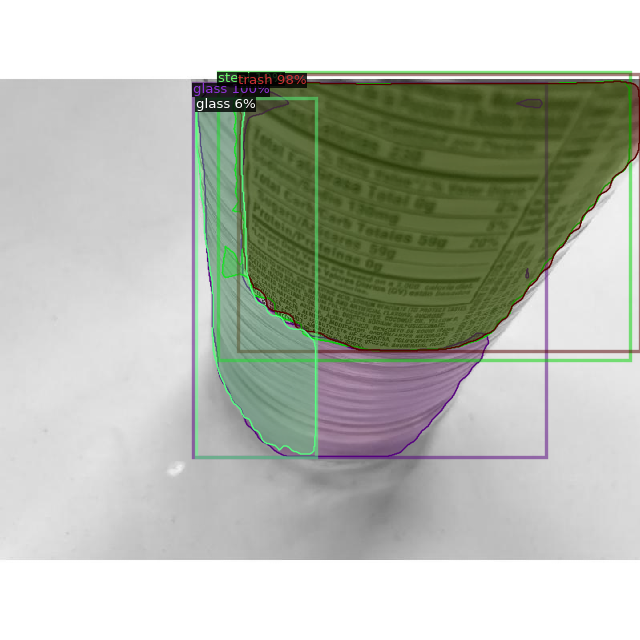

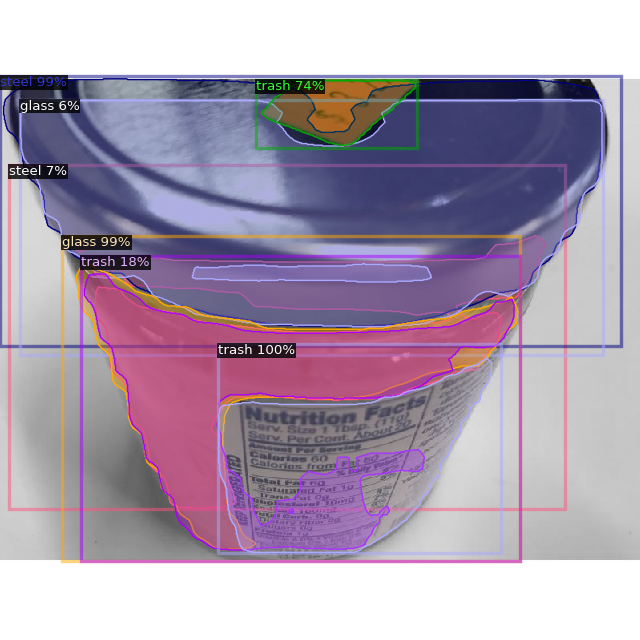

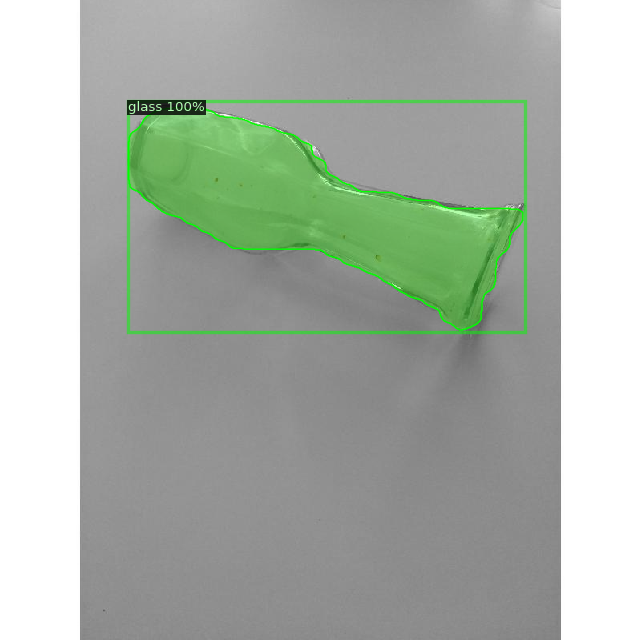

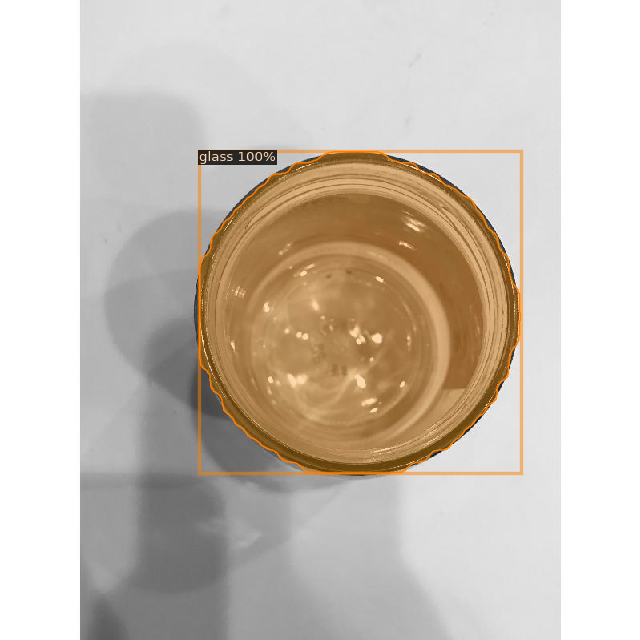

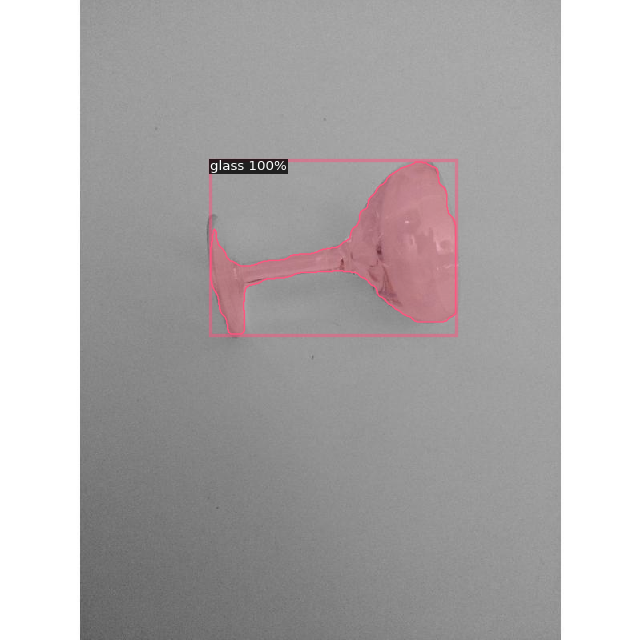

In [21]:
# 훈련이 잘 되었는지 test data로 확인

dataset_test = DatasetCatalog.get(TEST_DATA_SET_NAME)
metadata = MetadataCatalog.get(TEST_DATA_SET_NAME)

for d in dataset_test:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

# Final result

[12/04 12:29:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from Seperation-of-waste-by-materials/mask_rcnn_R_101_FPN_3x/2023-12-04-11-43-49/model_final.pth ...
WARNING [12/04 12:29:52 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/04 12:29:52 d2.data.datasets.coco]: Loaded 64 images in COCO format from /content/Seperation-of-waste-by-materials-10/test/_annotations.coco.json


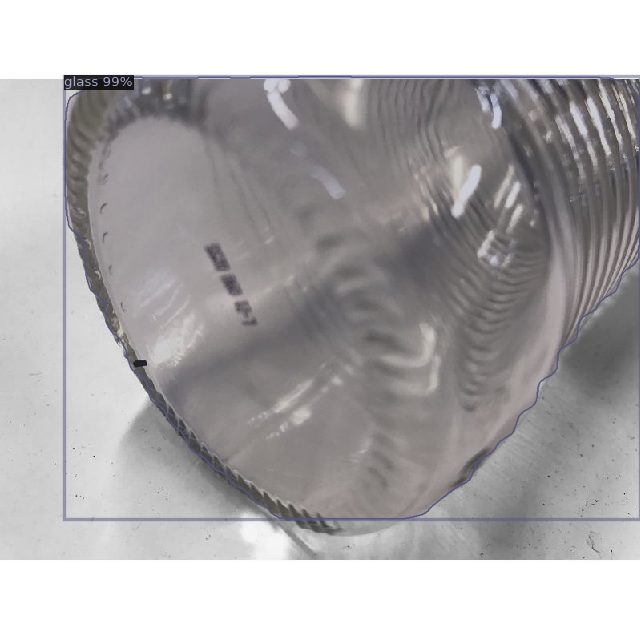

입력된 쓰레기 이미지에서 확인된 물질 종류는 ['glass']  입니다.
glass: 유리로 분리배출 해주세요.:)


In [25]:
# 최종 출력 단계: test data에서 임의로 사진을 골라 image segmentation 진행
# --> 사용자에게 분리수거 방법 안내

import random
import numpy as np

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

# Get dataset metadata
metadata = MetadataCatalog.get(TEST_DATA_SET_NAME)

# Get dataset dictionary
dataset_test = DatasetCatalog.get(TEST_DATA_SET_NAME)

# Choose a random image index
random_image_index = random.randint(0, len(dataset_test) - 1)

# Load the image and annotations using the chosen index
image_dict = dataset_test[random_image_index]

# Visualize the image with annotations
img = cv2.imread(image_dict["file_name"])
outputs = predictor(img)
visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.8,instance_mode=ColorMode.IMAGE_BW)
out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])


# Get the segmentation masks and classes
masks = outputs["instances"].pred_masks
classes = outputs["instances"].pred_classes

# Convert the masks and classes to NumPy arrays
masks_np = masks.cpu().numpy()
classes_np = classes.cpu().numpy()

# Initialize a list to store class names
class_names_list = []

# Loop through all instances in the predictions
for instance_index in range(len(outputs["instances"])):
    # Get the segmentation class for the current instance
    segmentation_class = classes_np[instance_index]

    # Get the class name
    class_name = metadata.thing_classes[segmentation_class]

    # Append the class name to the list
    class_names_list.append(class_name)

# Print the list of class names
print("입력된 쓰레기 이미지에서 확인된 물질 종류는", class_names_list, " 입니다.")

if 'trash' in class_names_list:
  print("trash: 일반 쓰레기로 버려주세요.:)")

if 'glass' in class_names_list:
  print("glass: 유리로 분리배출 해주세요.:)")

if 'plastic' in class_names_list:
  print("plastic: 플라스틱으로 분리배출 해주세요.:)")

if 'vinyl' in class_names_list:
  print("vinyl: 비닐로 분리배출 해주세요.:)")

if 'paper' in class_names_list:
  print("paper: 종이로 분리배출 해주세요.:)")

if 'rubber' in class_names_list:
  print("rubber: 일반 쓰레기로 버려주세요.:)")

if 'steel' in class_names_list:
  print("steel: 철/캔으로 분리배출 해주세요.:)")